In [2]:
import keras
import tensorflow as tf
import gdal
import os
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
from keras_unet.models import custom_unet, satellite_unet
from keras_unet.metrics import iou, iou_thresholded
from keras_unet.losses import jaccard_distance
from keras_unet.utils import plot_segm_history

2023-07-12 09:36:38.348435: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-07-12 09:36:38.349959: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-07-12 09:36:38.381648: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-07-12 09:36:38.382139: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-12 09:36:39.016536: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

-----------------------------------------
keras-unet init: TF version is >= 2.0.0 - using `tf.keras` instead of `Keras`
-----------------------------------------


In [4]:
base_dir = Path(r'/media/studentuser/PATRIOT/training')
mask_dir = base_dir.joinpath('masks_img')
image_dir = base_dir.joinpath('img')
water_dir = mask_dir.joinpath('water_img')
shrubs_dir = mask_dir.joinpath('shrubs_img')
poly_dir = mask_dir.joinpath('polygonal_img')
trees_dir = mask_dir.joinpath('trees_img')
low_dir = mask_dir.joinpath('low_density_img')

In [5]:
def make_path(img_dir, prefix, number):
    return os.path.join(img_dir, f"{prefix}_{number}.tif")

In [6]:
def img_number(fpath: str) -> int:
    return int(os.path.splitext(os.path.split(fpath)[1])[0].split('_')[-1])

In [64]:
def load_image(path: str) -> np.ndarray:
    ds = gdal.Open(path, gdal.GA_ReadOnly)
    return ds.GetRasterBand(1).ReadAsArray()

In [65]:
def load_stack(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        stack[i, :, :] = load_image(image_path)
    return stack

def load_stack_safely(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        if not os.path.isfile(image_path):
            print("skipping", image_path)
            continue
        stack[i, :, :] = load_image(image_path)
    return stack

In [66]:
I = 200
N = 256
M = 256
V = 5

In [12]:
train_images = load_stack((I, N, M), np.float32, image_dir, "img")
train_images_R = train_images.reshape(I, N, M, 1)

In [13]:
train_images_R.shape

(200, 256, 256, 1)

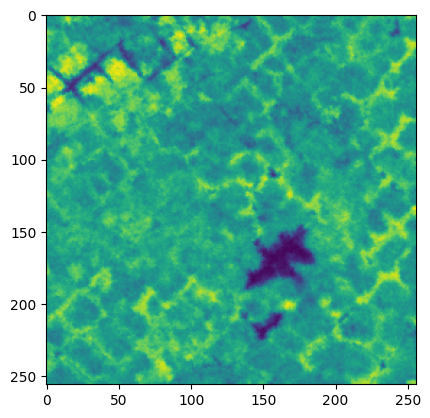

In [14]:
plt.imshow(train_images[1, :,:])

In [15]:
water_mask = load_stack_safely((I, N, M), np.int8, water_dir, "water")
poly_mask = load_stack_safely((I, N, M), np.int8, poly_dir, "polygonal")
trees_mask = load_stack_safely((I, N, M), np.int8, trees_dir, "tree")
shrubs_mask = load_stack_safely((I, N, M), np.int8, shrubs_dir, "shrub")
low_mask = load_stack_safely((I, N, M), np.int8, low_dir, "low")

skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_2.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_7.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_10.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_13.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_15.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_22.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_23.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_24.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_35.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_36.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_38.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_40.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/w

skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_73.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_75.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_80.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_87.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_89.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_91.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_92.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_96.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_98.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_101.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_102.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_103.tif
skipping /media/studentuser/PATRIOT/training/mask

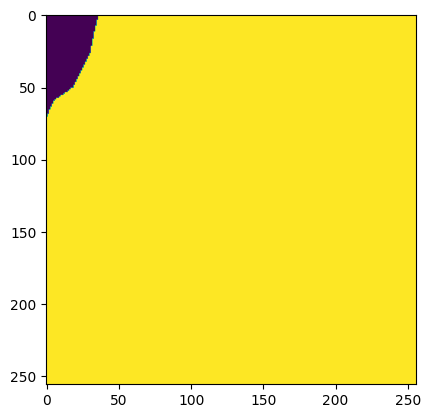

In [16]:
plt.imshow(low_mask[165, :,:])

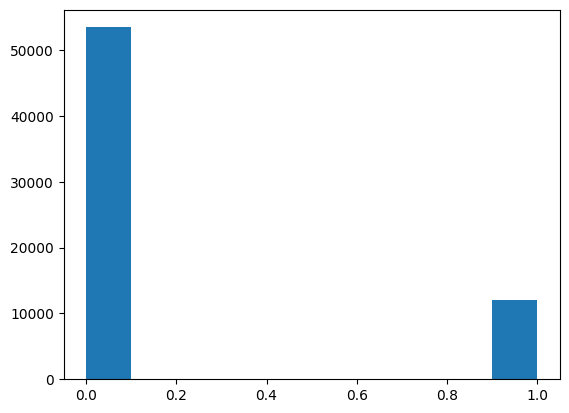

In [17]:
plt.hist(poly_mask[0, :,:].flatten())
plt.show()

In [18]:
model = satellite_unet((N, M, 1), V)

2023-07-12 09:37:19.926177: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1956] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


In [19]:
model.compile(
    optimizer = tf.keras.optimizers.Adam(),
    loss = "binary_crossentropy",
    metrics = [iou, iou_thresholded],
)

In [20]:
# Image 13 held out due to low image quality from smoke

W = 159
Y = np.zeros(shape=(W, N, M, 5), dtype =np.int8)
Y_train_img = np.zeros(shape=(W, N, M, 1), dtype =np.float32)

Y[0:12, :, :, 0] = trees_mask[0:12, :, :]
Y[0:12, :, :, 1] = poly_mask[0:12, :, :]
Y[0:12, :, :, 2] = water_mask[0:12, :, :]
Y[0:12, :, :, 3] = shrubs_mask[0:12, :, :]
Y[0:12, :, :, 4] = low_mask[0:12, :, :]
Y_train_img[0:12, :, :, 0] = train_images_R[0:12, :, :, 0]

Y[12:W, :, :, 0] = trees_mask[13:W+1, :, :]
Y[12:W, :, :, 1] = poly_mask[13:W+1, :, :]
Y[12:W, :, :, 2] = water_mask[13:W+1, :, :]
Y[12:W, :, :, 3] = shrubs_mask[13:W+1, :, :]
Y[12:W, :, :, 4] = low_mask[13:W+1, :, :]
Y_train_img[12:W, :, :, 0] = train_images_R[13:W+1, :, :, 0]

In [21]:
# Image 175 held out due to low image quality from smoke

K = 39
Y_valid = np.zeros(shape=(K, N, M, V), dtype =np.int8)
Y_valid_img = np.zeros(shape=(K, N, M, 1), dtype =np.float32)

Y_valid[0:14, :, :, 0] = trees_mask[160:174, :, :]
Y_valid[0:14, :, :, 1] = poly_mask[160:174, :, :]
Y_valid[0:14, :, :, 2] = water_mask[160:174, :, :]
Y_valid[0:14, :, :, 3] = shrubs_mask[160:174, :, :]
Y_valid[0:14, :, :, 4] = low_mask[160:174, :, :]
Y_valid_img[0:14, :, :, 0] = train_images_R[160:174, :, :, 0]

Y_valid[14:K, :, :, 0] = trees_mask[175:200, :, :]
Y_valid[14:K, :, :, 1] = poly_mask[175:200, :, :]
Y_valid[14:K, :, :, 2] = water_mask[175:200, :, :]
Y_valid[14:K, :, :, 3] = shrubs_mask[175:200, :, :]
Y_valid[14:K, :, :, 4] = low_mask[175:200, :, :]
Y_valid_img[14:K, :, :, 0] = train_images_R[175:200, :, :, 0]

In [22]:
low_mask[46, :,:]

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int8)

In [23]:
Y[45,:,:,4]

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int8)

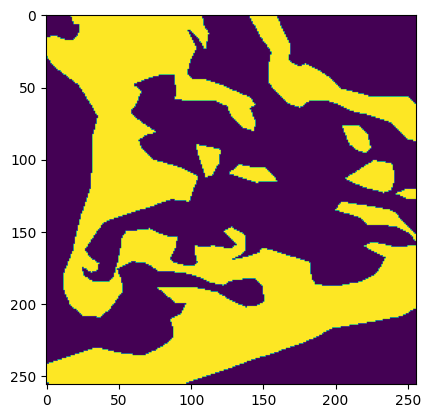

In [25]:
plt.imshow(Y[10,:,:,4])

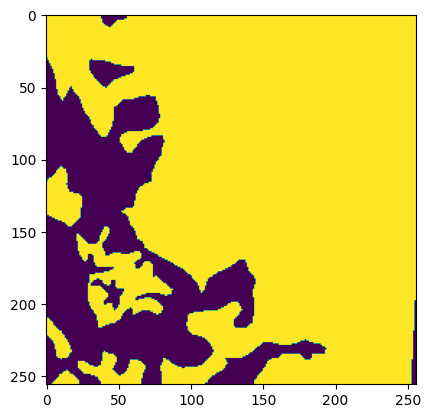

In [26]:
plt.imshow(water_mask[11,:, :])

In [27]:
Y_valid_img.shape

(39, 256, 256, 1)

In [28]:
Y.shape

(159, 256, 256, 5)

In [31]:
history = model.fit(Y_train_img, Y, epochs = 200)

Epoch 1/200
5/5 [==============================] - 28s 4s/step - loss: 0.7342 - iou: 0.1419 - iou_thresholded: 0.1810
Epoch 2/200
5/5 [==============================] - 22s 4s/step - loss: 0.3695 - iou: 0.1717 - iou_thresholded: 0.1942
Epoch 3/200
5/5 [==============================] - 22s 4s/step - loss: 0.3061 - iou: 0.2055 - iou_thresholded: 0.2541
Epoch 4/200
5/5 [==============================] - 21s 4s/step - loss: 0.2994 - iou: 0.2461 - iou_thresholded: 0.2789
Epoch 5/200
5/5 [==============================] - 22s 4s/step - loss: 0.2871 - iou: 0.2442 - iou_thresholded: 0.2658
Epoch 6/200
5/5 [==============================] - 21s 4s/step - loss: 0.2567 - iou: 0.2778 - iou_thresholded: 0.3387
Epoch 7/200
5/5 [==============================] - 21s 4s/step - loss: 0.2693 - iou: 0.2611 - iou_thresholded: 0.3064
Epoch 8/200
5/5 [==============================] - 22s 4s/step - loss: 0.2757 - iou: 0.2550 - iou_thresholded: 0.2892
Epoch 9/200
5/5 [==============================] - 21s 4

5/5 [==============================] - 21s 4s/step - loss: 0.1692 - iou: 0.4274 - iou_thresholded: 0.4957
Epoch 70/200
5/5 [==============================] - 21s 4s/step - loss: 0.1831 - iou: 0.4233 - iou_thresholded: 0.5042
Epoch 71/200
5/5 [==============================] - 21s 4s/step - loss: 0.1713 - iou: 0.4416 - iou_thresholded: 0.5342
Epoch 72/200
5/5 [==============================] - 21s 4s/step - loss: 0.1870 - iou: 0.4138 - iou_thresholded: 0.4873
Epoch 73/200
5/5 [==============================] - 21s 4s/step - loss: 0.1832 - iou: 0.4164 - iou_thresholded: 0.4995
Epoch 74/200
5/5 [==============================] - 21s 4s/step - loss: 0.1684 - iou: 0.4304 - iou_thresholded: 0.5158
Epoch 75/200
5/5 [==============================] - 21s 4s/step - loss: 0.1809 - iou: 0.4161 - iou_thresholded: 0.4919
Epoch 76/200
5/5 [==============================] - 21s 4s/step - loss: 0.1581 - iou: 0.4587 - iou_thresholded: 0.5545
Epoch 77/200
5/5 [==============================] - 21s 4s/st

5/5 [==============================] - 21s 4s/step - loss: 0.1239 - iou: 0.5983 - iou_thresholded: 0.6914
Epoch 138/200
5/5 [==============================] - 21s 4s/step - loss: 0.1190 - iou: 0.5852 - iou_thresholded: 0.6833
Epoch 139/200
5/5 [==============================] - 21s 4s/step - loss: 0.1154 - iou: 0.5916 - iou_thresholded: 0.6976
Epoch 140/200
5/5 [==============================] - 21s 4s/step - loss: 0.1040 - iou: 0.6089 - iou_thresholded: 0.7149
Epoch 141/200
5/5 [==============================] - 21s 4s/step - loss: 0.1039 - iou: 0.6239 - iou_thresholded: 0.7306
Epoch 142/200
5/5 [==============================] - 21s 4s/step - loss: 0.1099 - iou: 0.6200 - iou_thresholded: 0.7109
Epoch 143/200
5/5 [==============================] - 21s 4s/step - loss: 0.1055 - iou: 0.6221 - iou_thresholded: 0.7139
Epoch 144/200
5/5 [==============================] - 21s 4s/step - loss: 0.0932 - iou: 0.6498 - iou_thresholded: 0.7458
Epoch 145/200
5/5 [==============================] - 2

In [34]:
modelsave_path = Path(r'/media/studentuser/PATRIOT/models/1971/model_1/saved_model1')

In [35]:
model.save(modelsave_path)

2023-07-12 10:48:21.497230: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype float and shape [?,?,?,64]
	 [[{{node inputs}}]]
2023-07-12 10:48:21.585527: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype float and shape [?,?,?,64]
	 [[{{node inputs}}]]
2023-07-12 10:48:21.669366: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype float and shape [?,?,?,64]
	 [[{{node inputs}}]]
2023-07

INFO:tensorflow:Assets written to: /media/studentuser/PATRIOT/models/1971/model_1/saved_model1/assets


INFO:tensorflow:Assets written to: /media/studentuser/PATRIOT/models/1971/model_1/saved_model1/assets


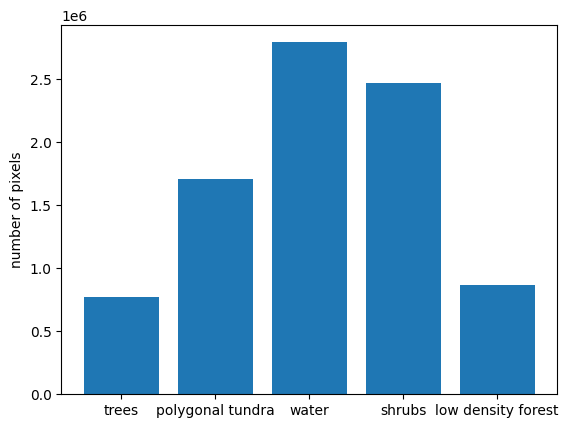

In [36]:
fig, ax = plt.subplots()
ax.bar(range(V), [trees_mask.sum(), poly_mask.sum(), water_mask.sum(), shrubs_mask.sum(), low_mask.sum()])
ax.set_xticks((0, 1, 2, 3, 4))
ax.set_xticklabels(('trees', 'polygonal tundra', 'water', 'shrubs', 'low density forest'))
plt.ylabel('number of pixels')
plt.show()

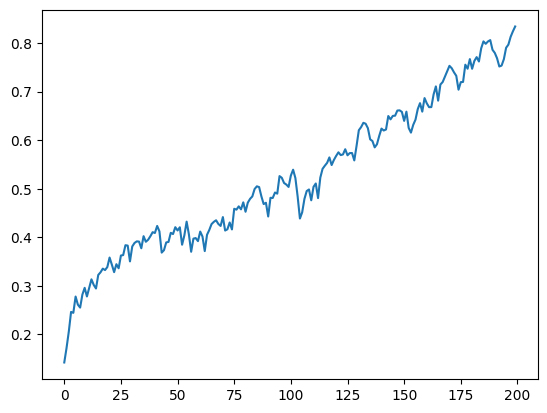

In [37]:
plt.plot(history.history['iou'])

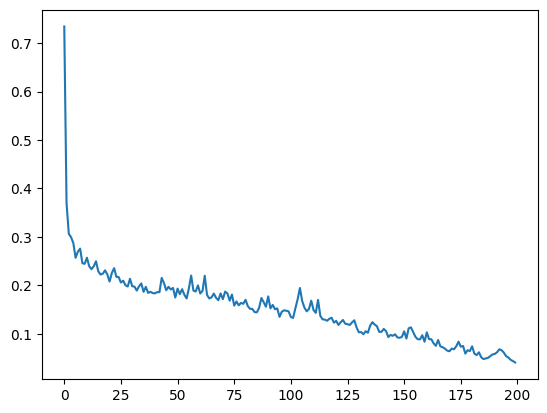

In [38]:
plt.plot(history.history['loss'])

In [39]:
Y_pred = model.predict(Y_train_img)

5/5 [==============================] - 8s 1s/step


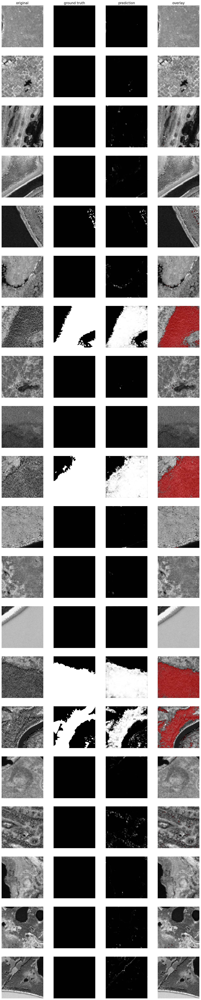

In [40]:
from keras_unet.utils import plot_imgs

# Trees
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 0], 
    pred_imgs=Y_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

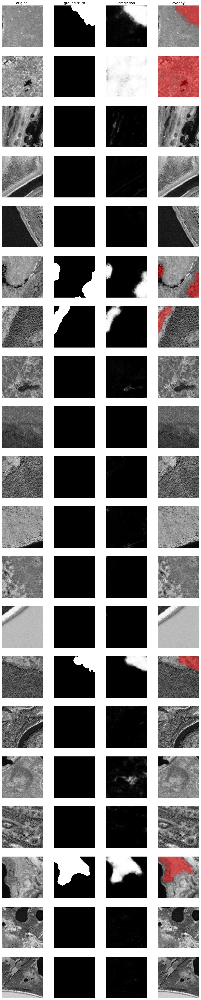

In [41]:
# Polygonal Tundra
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 1], 
    pred_imgs=Y_pred[:, :, :, 1], 
    nm_img_to_plot=20
  )

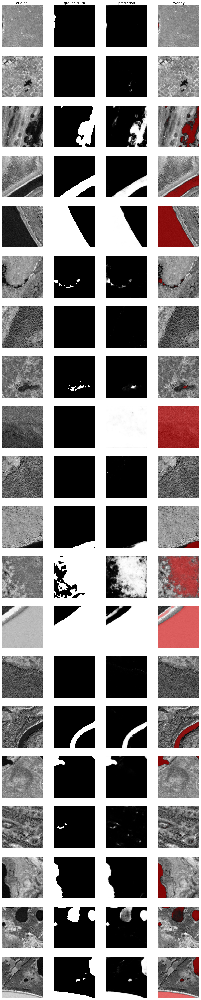

In [42]:
# Water
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 2], 
    pred_imgs=Y_pred[:, :, :, 2], 
    nm_img_to_plot=20
  )

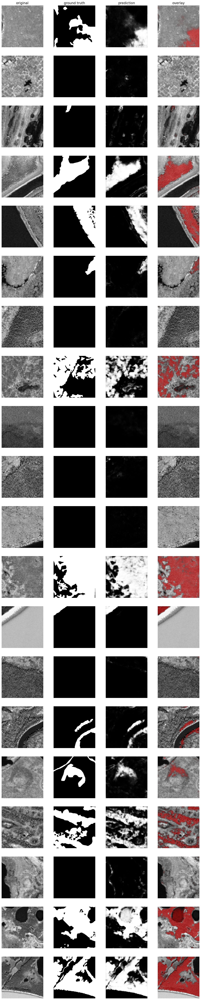

In [43]:
# Shrubs
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 3], 
    pred_imgs=Y_pred[:, :, :, 3], 
    nm_img_to_plot=20
  )

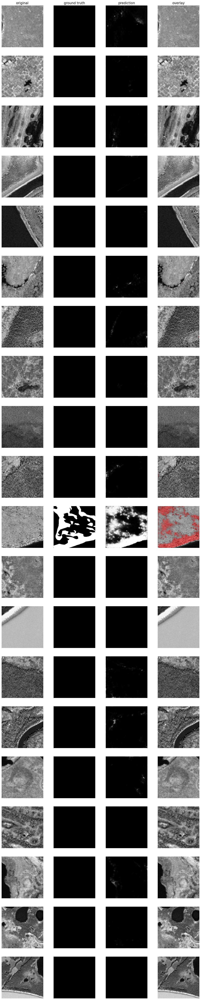

In [44]:
# Low density forest
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 4], 
    pred_imgs=Y_pred[:, :, :, 4], 
    nm_img_to_plot=20
  )

In [45]:
valid_pred = model.predict(Y_valid_img)

2/2 [==============================] - 2s 438ms/step


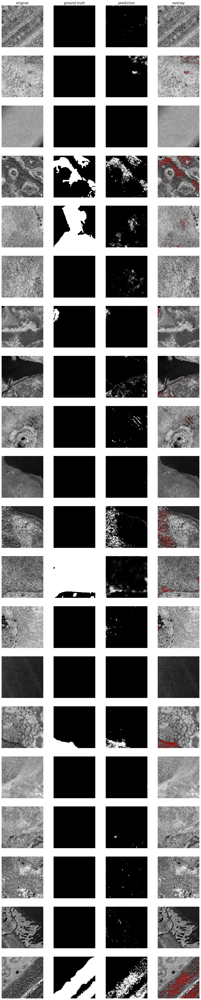

In [46]:
# Trees
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 0], 
    pred_imgs=valid_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

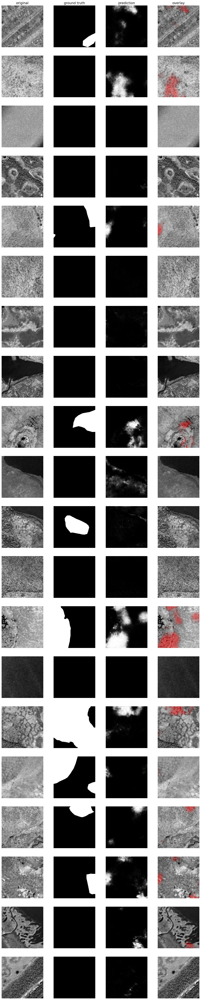

In [47]:
# Polygonal Tundra
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 1], 
    pred_imgs=valid_pred[:, :, :, 1], 
    nm_img_to_plot=20
  )

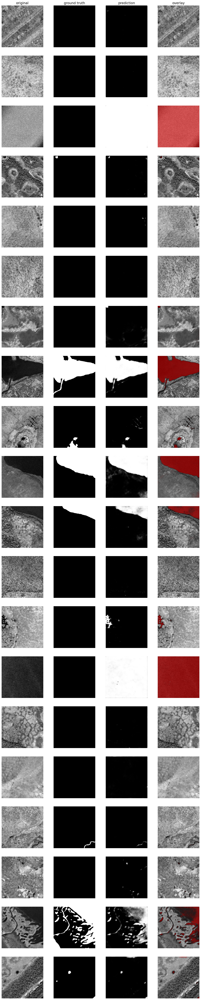

In [48]:
# Water
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 2], 
    pred_imgs=valid_pred[:, :, :, 2], 
    nm_img_to_plot=20
  )

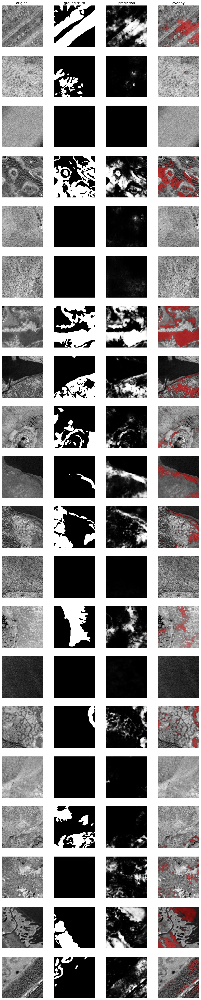

In [49]:
# Shrubs
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 3], 
    pred_imgs=valid_pred[:, :, :, 3], 
    nm_img_to_plot=20
  )

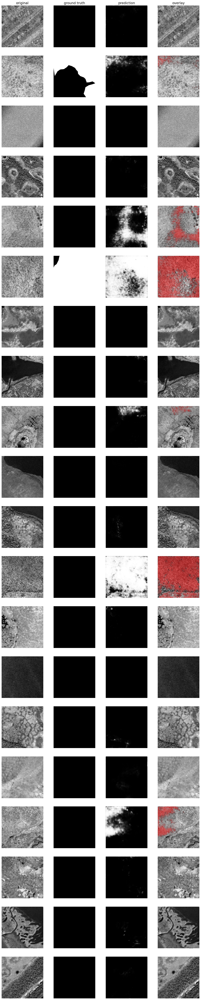

In [50]:
# Low density forest
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 4], 
    pred_imgs=valid_pred[:, :, :, 4], 
    nm_img_to_plot=20
  )

In [52]:
Y_valid[0,0,0,0]

0

In [53]:
treePredict = Y_valid[:,:,:,0]

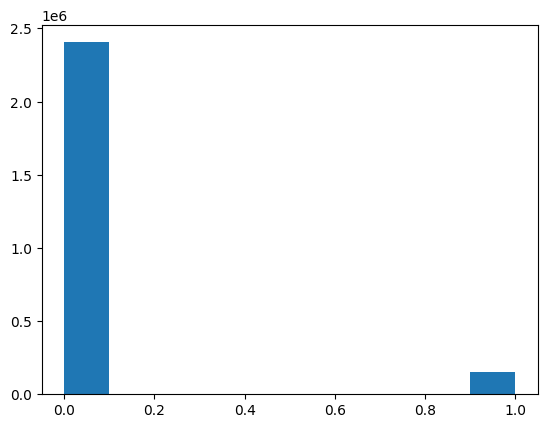

In [54]:
plt.hist(treePredict.flatten())
plt.show()

In [55]:
base_dirP = Path(r'/media/studentuser/PATRIOT/training/img')

In [59]:
J, N, M = 200, 256, 256

In [69]:
predict_img = load_stack_safely((J, N, M), np.float32,base_dirP, "img")

In [70]:
predict_img.shape

(200, 256, 256)

In [71]:
driver = gdal.GetDriverByName("GTiff")

In [72]:
driver.Register()

2

In [73]:
def load_stack_nt(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape=shape, dtype=dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        stack[i, :, :] = load_image_no_trim(image_path)
    return stack

In [78]:
def save_predict_valid( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(160,174):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(Y_valid[i-160,:,:,0])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None
                   
    for i in range(175,(160+nImg+1)):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(Y_valid[i-161,:,:,0])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [79]:
tree_valid_dir = r'/media/studentuser/PATRIOT/predictions_71/valid/tree'
save_predict_valid(nImg = 39,xdim= 256, ydim= 256,img_dir = tree_valid_dir,prefix = "tree_predict",orig_dir = image_dir , prefix_orig = "img")

In [80]:
def save_predict_validP( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(160,174):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(Y_valid[i-160,:,:,1])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None
                   
    for i in range(175,(160+nImg+1)):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(Y_valid[i-161,:,:,1])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [81]:
poly_valid_dir = r'/media/studentuser/PATRIOT/predictions_71/valid/poly'
save_predict_valid(nImg = 39,xdim= 256, ydim= 256,img_dir = poly_valid_dir,prefix = "poly_predict",orig_dir = image_dir , prefix_orig = "img")

In [82]:
def save_predict_validW( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(160,174):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(Y_valid[i-160,:,:,2])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None
                   
    for i in range(175,(160+nImg+1)):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(Y_valid[i-161,:,:,2])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [83]:
water_valid_dir = r'/media/studentuser/PATRIOT/predictions_71/valid/water'
save_predict_valid(nImg = 39,xdim= 256, ydim= 256,img_dir = water_valid_dir,prefix = "water_predict",orig_dir = image_dir , prefix_orig = "img")

In [84]:
def save_predict_validS( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(160,174):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(Y_valid[i-160,:,:,3])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None
                   
    for i in range(175,(160+nImg+1)):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(Y_valid[i-161,:,:,3])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [85]:
shrub_valid_dir = r'/media/studentuser/PATRIOT/predictions_71/valid/shrub'
save_predict_valid(nImg = 39,xdim= 256, ydim= 256,img_dir = shrub_valid_dir,prefix = "shrub_predict",orig_dir = image_dir , prefix_orig = "img")

In [86]:
def save_predict_validL( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(160,174):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(Y_valid[i-160,:,:,4])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None
                   
    for i in range(175,(160+nImg+1)):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(Y_valid[i-161,:,:,4])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [87]:
lowD_valid_dir = r'/media/studentuser/PATRIOT/predictions_71/valid/lowD'
save_predict_valid(nImg = 198,xdim= 256, ydim= 256,img_dir = lowD_valid_dir,prefix = "lowD_predict",orig_dir = image_dir , prefix_orig = "img")

ERROR 4: /media/studentuser/PATRIOT/training/img/img_201.tif: No such file or directory


AttributeError: 'NoneType' object has no attribute 'GetGeoTransform'